In [67]:
import librosa
import librosa.display
import IPython.display as display
import matplotlib.pyplot as plt
import numpy as np

In [41]:
firstlovepiano_file = "E:\Dropbox\WMP\Piano\First Love (duet) - piano.mp3"
butterfly_file = "E:\Dropbox\WMP\Japanese\Wait For You - 4D Feat 8utterfly.mp3"
callmesick_file = "E:\Dropbox\WMP\Japanese\Call Me Sick - Rei (Reina - E-girls) on THE FIRST TAKE.mp3"

In [42]:
display.Audio(firstlovepiano_file)

In [14]:
display.Audio(butterfly_file)

In [15]:
display.Audio(callmesick_file)

In [43]:
firstlovepiano,sr = librosa.load(firstlovepiano_file,
                       sr=22050,
                       mono = True) 
#these are defaults for sr and mono (mono False would load as stereo which isnt typically done)

butterfly, _ = librosa.load(butterfly_file)
callmesick, _ = librosa.load(callmesick_file)

C:\Users\Brandon\miniconda3\envs\tensorflowenv\lib\site-packages\librosa\core\audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [44]:
print(len(firstlovepiano)) #Massive numpy array!

6250752


In [45]:
# Duration of 1 sample
sample_duration = 1/sr
print("Duration of 1 sample is: %0.6f"%sample_duration)

Duration of 1 sample is: 0.000045


In [46]:
songs = [firstlovepiano,butterfly,callmesick]
song_names = ["FirstLovePiano","Butterfly","Callmesick"]
for i,j in zip(song_names,songs):
    duration_of_song = sample_duration * len(j) #duration of 1 sample in seconds * number of samples
    print("The song %s is %0.2fs long"%(i,duration_of_song))

The song FirstLovePiano is 283.48s long
The song Butterfly is 284.11s long
The song Callmesick is 247.26s long


If we wanted to truncate songs to only 30s intros ...

In [64]:
seconds30 = int(30/sample_duration)
print("The number of samples required to make 30 seconds is: ",seconds30)

The number of samples required to make 30 seconds is:  661500


# Visualizing waveforms

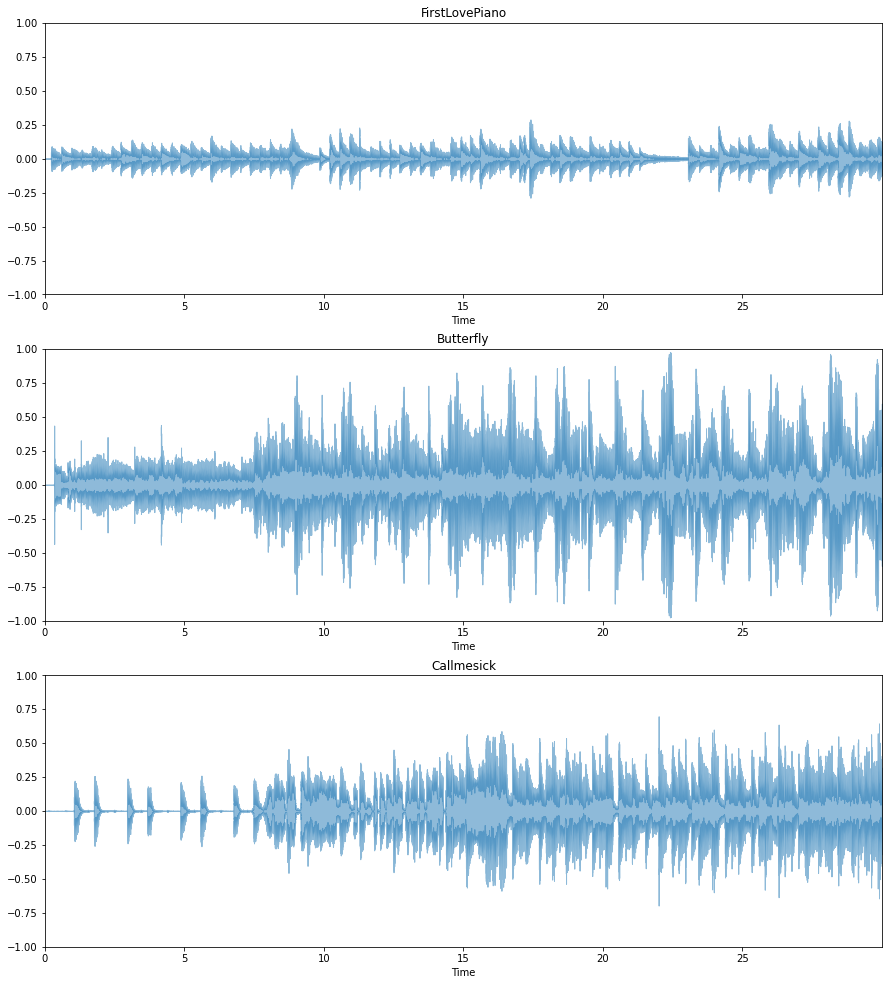

In [65]:
plt.figure(figsize = (15,17))

for i,val in enumerate(songs):
    plt.subplot(3,1,i+1)
    librosa.display.waveplot(val[:seconds30],alpha=0.5)
    plt.title(song_names[i])
    plt.ylim((-1,1))

Here we observe that a quiet song like First Love piano doesnt have large amplitudes and additionally has moments of silence.

Butterfly is your typical pop song and has a very regular spike in amplitude indicating the bass drum thump.

Callmesick has the piano keeping the beat in the intro which transitions to the same as Butterfly, a bass drum thumping 

# Computing Amplitude Env

In [75]:
def AE(signal,frame_size,hop_length):
    '''
    Amplitude Envelope (AE) is the max() amplitude of ALL SAMPLES in the GIVEN FRAME
    
    Args:
    signal = your librosa.load() variable
    frame_size = the number of samples that create 1 frame
    hop_length = the window step between 1 frame and the next (set to frame_size / 2 if you want overlapping frames)
    '''
    AE = []
    for i in range(0,len(signal),hop_length): #Iterate between all samples with step-size of Hop_length
        AE.append(max(signal[i:i+frame_size])) #Find the max in the frame & append
    return np.array(AE)

In [81]:
FRAME_SIZE = 1024
HOP_LENGTH = 512 #FRAME_SIZE/2

firstlovepiano_AE = AE(firstlovepiano,FRAME_SIZE,HOP_LENGTH)
butterfly_AE = AE(butterfly,FRAME_SIZE,HOP_LENGTH)
callmesick_AE = AE(callmesick,FRAME_SIZE,HOP_LENGTH)

AE_vals = [firstlovepiano_AE,butterfly_AE,callmesick_AE]
len(firstlovepiano_AE)

12209

Visualize the AE for all songs
- Compute frames to time --- otherwise it wont fit sidebyside with the waveform plot
- Then plot them together

In [96]:
times = []
for i in AE_vals:
    frames = range(0,len(i))
    times.append(librosa.frames_to_time(frames,hop_length=HOP_LENGTH))

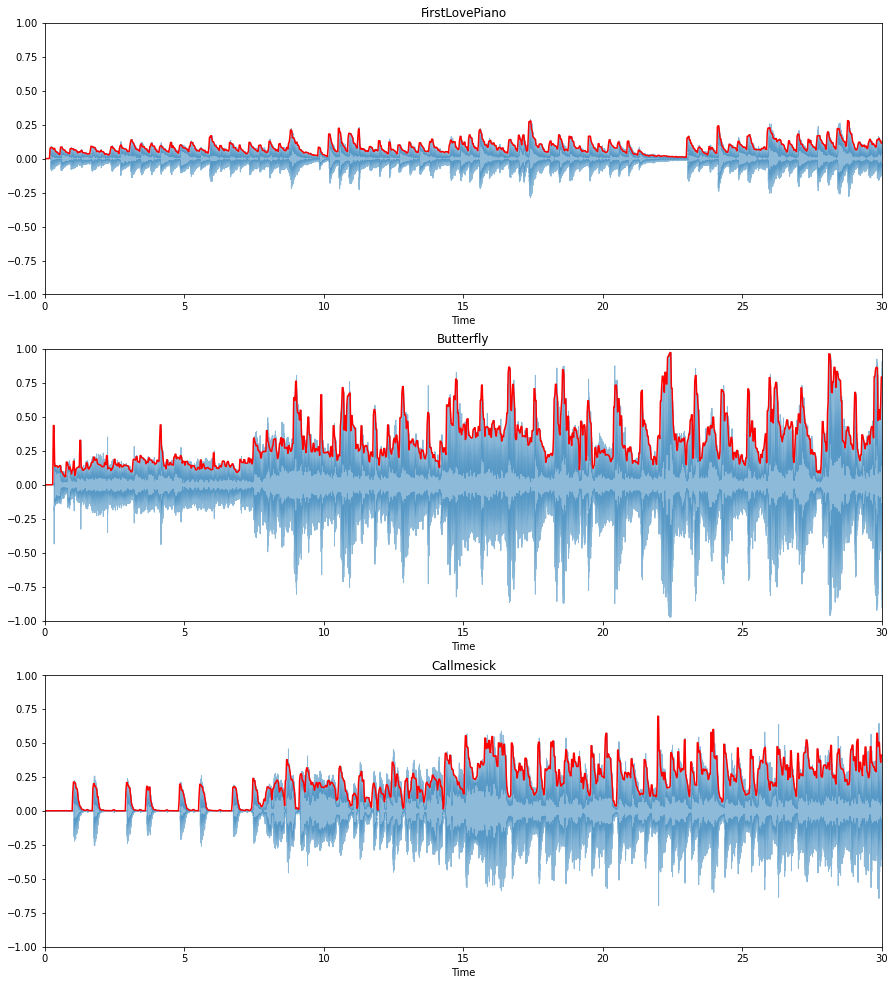

In [100]:
plt.figure(figsize = (15,17))

i = 0
for song,ampenv,t in zip(songs,AE_vals,times):
    plt.subplot(3,1,i+1)
    librosa.display.waveplot(song,alpha=0.5)
    plt.plot(t,ampenv,color='r')
    plt.title(song_names[i])
    plt.ylim((-1,1))
    plt.xlim((0,30)) #0 to 30 seconds
    i += 1

Observations:

Super poppy & Rock songs (Butterfly) have large spikes in AE which allow them to be classified by machine learning quite easily.

Meanwhile slow songs (FirstLovePiano) don't have much in terms of spikes __and__ their average AE is quite small

Callmesick is in the middle-ground as a pop song which has some heavy bass kit drums and is quite spiky from that, but has a lower average(AE) than Butterfy

In [112]:
for i in range(3):
    print("Average AE value for %s is %0.2f"%(song_names[i],AE_vals[i].mean()))

Average AE value for FirstLovePiano is 0.16
Average AE value for Butterfly is 0.59
Average AE value for Callmesick is 0.38


# Root Mean Square Energy (RMSE)

In [123]:
firstlovepiano_rms = librosa.feature.rms(firstlovepiano,frame_length=FRAME_SIZE,hop_length=HOP_LENGTH)
butterfly_rms = librosa.feature.rms(butterfly,frame_length=FRAME_SIZE,hop_length=HOP_LENGTH)
callmesick_rms = librosa.feature.rms(callmesick,frame_length=FRAME_SIZE,hop_length=HOP_LENGTH)

RMS_vals = [firstlovepiano_rms,butterfly_rms,callmesick_rms]

In [124]:
firstlovepiano_rms #shape (1,12209) --- need to trim to (,12209)

array([[0.        , 0.        , 0.        , ..., 0.00796392, 0.00670926,
        0.00421438]], dtype=float32)

In [125]:
RMS_vals = [i[0] for i in RMS_vals] #This will trim the nonsense dimsension off

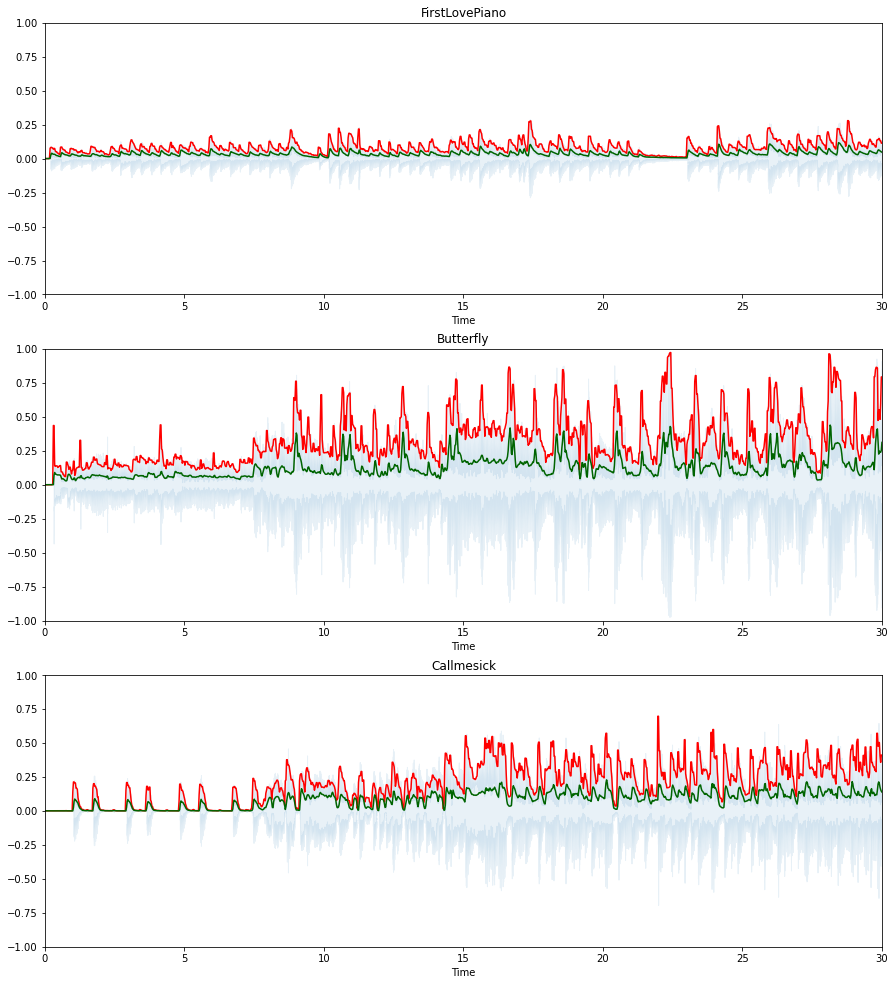

In [131]:
# Plot RMSE and AE sidebyside for comparison

plt.figure(figsize=(15,17))

i = 0
for song,ampenv,t,rmse in zip(songs,AE_vals,times,RMS_vals):
    plt.subplot(3,1,i+1)
    librosa.display.waveplot(song,alpha=0.1)
    plt.plot(t,ampenv,color='r')
    plt.plot(t,rmse,color='darkgreen')
    plt.title(song_names[i])
    plt.ylim((-1,1))
    plt.xlim((0,30)) #0 to 30 seconds
    i += 1

Above charts have the following color scheme: <br>
    - <font color='red'>red</font> is Amplitude Envelope <br>
    - <font color='green'>green</font> is Root-mean square Energy


RMSE = Root-mean-Square of all sample amplitude in the given frame
AE = max() of all sample amplitude in the given frame

This means that both are measuring amplitiude, but AE tends to be very sensitive to outliers as it'll just select the max

Meanwhile RMSE will smooth out and is less sensitive to outliers like a singer abruptly brushing onto the microphone